# капот

In [1]:
import os
import sys

module_path = os.path.abspath(os.path.join(".."))
if module_path not in sys.path:
    sys.path.append(module_path)
import models
import matplotlib.pyplot as plt
import numpy as np
import torch
from fpdf import FPDF
import random
from datetime import datetime
import csv
from omegaconf import OmegaConf
import pyedflib
from scipy import signal, stats

import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
import seaborn as sns

## Полезные функции

In [2]:
# === Функции ===
def edf_extractor(file_name):
    f = pyedflib.EdfReader(file_name)
    n = f.signals_in_file
    signal_labels = f.getSignalLabels()
    sigbufs = np.zeros((n, f.getNSamples()[0]))
    for i in np.arange(n):
        sigbufs[i, :] = f.readSignal(i)
    return sigbufs, signal_labels


def build_model(cfg):
    ckpt_path = cfg.upstream_ckpt
    init_state = init_state = torch.load(ckpt_path, weights_only=False)
    upstream_cfg = init_state["model_cfg"]
    upstream = models.build_model(upstream_cfg)
    return upstream


def load_model_weights(model, states, multi_gpu):
    if multi_gpu:
        model.module.load_weights(states)
    else:
        model.load_weights(states)


def initialize_model(ckpt_path: str):
    """
    Инициализация модели с заданным путем к контрольной точке (checkpoint).

    Args:
        ckpt_path (str): Путь к файлу контрольной точки.

    Returns:
        model: Инициализированная модель.
    """

    # Создание конфигурации и загрузка модели
    cfg = OmegaConf.create({"upstream_ckpt": ckpt_path})
    model = build_model(cfg)
    model.to("cuda")

    # Загрузка весов модели
    init_state = torch.load(ckpt_path, weights_only=False)
    load_model_weights(model, init_state["model"], False)

    return model


def create_save_dir(base_path: str) -> str:
    """Создаёт директорию с именем, основанным на текущей дате и времени."""
    timestamp = datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
    save_dir = os.path.join(base_path, timestamp)
    os.makedirs(save_dir, exist_ok=True)
    return save_dir


def read_intervals_from_csv(file_path: str):
    """Читает интервалы из CSV-файла."""
    intervals = []
    activities = []
    with open(file_path, mode="r", encoding="utf-8") as csv_file:
        csv_reader = csv.reader(csv_file)
        for row in csv_reader:
            activities.append(row[0])
            intervals.append((float(row[1]), float(row[2])))
    return activities, intervals


def extract_intervals(original_file_path):
    """
    Преобразует оригинальный TSV файл в переменные для дальнейшей работы: activities, intervals и activity_type.

    Args:
        original_file_path (str): Путь к оригинальному TSV файлу.

    Returns:
        tuple: Три списка - activities, intervals и activity_type.
    """
    import pandas as pd

    # Чтение оригинального TSV файла
    df = pd.read_csv(original_file_path, sep="\t")

    # Извлечение необходимых столбцов
    required_columns = [
        "onset",
        "duration",
        "item_name",
        "trial_type",
        "test",
        "answer",
    ]
    if not all(col in df.columns for col in required_columns):
        raise ValueError(
            f"Оригинальный файл должен содержать столбцы: {required_columns}"
        )

    # Формирование интервалов, где конец интервала это onset следующего элемента
    onset_list = df["onset"].tolist() + [0]  # Добавляем 0 в конец
    intervals = [(onset_list[i], onset_list[i + 1]) for i in range(len(onset_list) - 1)]

    # Формирование activity_type
    activity_type = df["trial_type"].tolist()

    # Формирование activities с условием для PROB
    activities = [
        f"{test} = {answer}" if trial_type == "PROB" else item_name
        for test, answer, trial_type, item_name in zip(
            df["test"], df["answer"], df["trial_type"], df["item_name"]
        )
    ]

    return activities, intervals, activity_type


def get_model_outputs(stfts, model):
    # Форматирование тензоров и инференс модели
    inputs = torch.FloatTensor(np.stack(stfts)).transpose(1, 2).to("cuda")
    mask = torch.zeros((inputs.shape[:2])).bool().to("cuda")

    with torch.no_grad():
        out = model.forward(inputs, mask, intermediate_rep=True)
    return out


def universal_label_and_merge(group, search_col, mapping, default_label="OTHER"):
    """
    Универсальная функция для разметки и объединения интервалов в рамках одного трайала.

    Аргументы:
        group (pd.DataFrame): Датафрейм с событиями одного трайала.
                              Обязательно должен содержать столбцы "onset" и "duration".
        search_col (str): Имя столбца, по которому производится сопоставление (например, "trial_type").
        mapping (dict): Словарь вида {new_label (str): set(исходных меток)}.
        default_label (str): Ярлык для событий, не попавших ни в одну группу из mapping.

    Возвращает:
        pd.DataFrame с колонками ["label", "start", "end"].
    """
    # 1. Сортировка по времени
    group_sorted = (
        group.loc[:, ["onset", "duration", search_col]]
        .sort_values("onset")
        .reset_index(drop=True)
    )

    # 2. Корректировка столбца "duration"
    ind = group_sorted.columns.get_loc("duration")
    dur = group_sorted.iloc[-1, ind]
    group_sorted["duration"] = (
        group_sorted["onset"].diff(periods=-1).apply(lambda x: x * -1)
    )
    group_sorted.iloc[-1, ind] = dur

    # 3. Присваиваем новый ярлык каждому событию
    reverse_mapping = {
        orig_label: new_label
        for new_label, orig_labels in mapping.items()
        for orig_label in orig_labels
    }
    group_sorted["label"] = (
        group_sorted[search_col].map(reverse_mapping).fillna(default_label)
    )

    # 4. Вычисление конечных точек (start, end)
    group_sorted["end"] = group_sorted["onset"] + group_sorted["duration"]

    # 5. Группировка подряд идущих событий с одинаковым `label`
    group_sorted["group"] = (
        group_sorted["label"] != group_sorted["label"].shift()
    ).cumsum()

    merged_df = group_sorted.groupby("group", as_index=False).agg(
        label=("label", "first"), start=("onset", "first"), end=("end", "last")
    )

    return merged_df[["label", "start", "end"]]

# Рабочее поле

### STFTProcessor

In [28]:
import numpy as np
import pandas as pd
from scipy import signal, stats
from typing import List, Tuple, Dict, Optional


class STFTProcessor:
    """
    Класс для обработки сигналов с использованием STFT (Кратковременное преобразование Фурье).

    Функционал:
    - Преобразует интервалы из секунд в дискретные отсчёты.
    - Корректирует интервалы, устраняя артефакты округления.
    - Объединяет или дополняет короткие интервалы.
    - Выполняет STFT на обработанных интервалах с возможностью нормализации.

    Формат входных данных:
    - Массив сигнала с размерностями (число каналов, пиксели сигнала)
    - Пандас датафрейм интервалов
    """

    @staticmethod
    def baseline(data: np.ndarray) -> np.ndarray:
        """Вычисляет базовую линию, вычитая среднее значение по оси."""
        return data - np.mean(data, axis=-1, keepdims=True)

    def __init__(
        self,
        fs: int,
        window_size: int,
        overlap: int,
        normalizing: Optional[str] = "zscore",
        debug: bool = False,
        clip_fs: int = 40,
    ):
        """
        Инициализация класса STFTProcessor.

        :param fs: Частота дискретизации (Гц)
        :param window_size: Размер окна для STFT
        :param overlap: Количество перекрывающихся отсчётов
        :param normalizing: Способ нормализации ('zscore', 'baselined', 'db' или None)
        :param debug: Флаг для вывода отладочной информации
        """
        self.fs = fs
        self.window_size = window_size
        self.overlap = overlap
        self.normalizing = normalizing
        self.debug = debug
        self.effective_length = window_size - overlap
        self.left_padding = window_size - self.effective_length
        self.threshold = self.effective_length // 2
        self.clip_fs = clip_fs
        if self.debug:
            print(
                "Initialized STFTProcessor with fs:",
                fs,
                "window_size:",
                window_size,
                "overlap:",
                overlap,
                "effective_length:",
                self.effective_length,
            )

    def _convert_intervals_to_samples(
        self, intervals_df: pd.DataFrame
    ) -> List[Dict[str, int]]:
        """
        Преобразует интервалы из секунд в отсчёты.

        :param intervals_df: DataFrame с колонками ["label", "start", "end"] в секундах
        :return: Список интервалов в отсчётах
        """
        if self.debug:
            print("Original intervals DataFrame (seconds):")
            print(intervals_df)

        intervals_df = intervals_df.copy()
        # Преобразование секунд в отсчёты
        intervals_df["start"] = (intervals_df["start"] * self.fs).round().astype(int)
        intervals_df["end"] = (intervals_df["end"] * self.fs).round().astype(
            int
        ) - 1  # Вычитание 1 для соответствия индексам

        if self.debug:
            print("After converting seconds to samples:")
            print(intervals_df)
            print("Data types after conversion:")
            print(intervals_df.dtypes)

        intervals_list = intervals_df.to_dict(orient="records")
        if self.debug:
            print("Final intervals as list of dictionaries:")
            for idx, interval in enumerate(intervals_list):
                print(f"Interval {idx}: {interval}")

        return intervals_list

    def _merge_or_extend_intervals(
        self, intervals_samples: List[Dict[str, int]]
    ) -> List[Dict[str, int]]:
        """
        Объединяет или дополняет короткие интервалы, чтобы избежать пропусков.

        :param intervals_samples: Список интервалов в отсчётах
        :return: Обновленный список интервалов
        """
        i = 0
        processed_intervals = []
        if self.debug:
            print("Original intervals_samples:", intervals_samples)
        while i < len(intervals_samples):
            current = intervals_samples[i]
            current_length = current["end"] - current["start"]
            modulo = current_length % self.effective_length
            division = current_length // self.effective_length
            needed = self.effective_length - modulo
            # Вычисляем available, считая, что интервалы заданы как закрытые [start, end]
            if i + 1 < len(intervals_samples):
                next_interval = intervals_samples[i + 1]
                available = next_interval["end"] - next_interval["start"] + 1
            if self.debug:
                print(f"[Interval {i}] START processing:")
                print(
                    f"  Current interval: start={current['start']}, end={current['end']}, length={current_length}"
                )
                print(
                    f"  Computed: modulo={modulo}, division={division}, threshold={self.threshold}"
                )

            if i + 1 < len(intervals_samples):
                # Если остаток превышает порог, пытаемся расширить или слить с следующим интервалом
                if modulo > self.threshold:
                    if self.debug:
                        print(
                            f"[Interval {i}] Condition: modulo ({modulo}) > threshold ({self.threshold})"
                        )
                        print(
                            f"  Needed samples to extend = {needed}, next interval available = {available}"
                        )
                    if available > needed:
                        next_interval["start"] += needed
                        current["end"] += needed
                        processed_intervals.append(current)
                        if self.debug:
                            print(f"[Interval {i}] EXTENDED current interval:")
                            print(f"  New current end = {current['end']}")
                            print(
                                f"  Next interval new start = {next_interval['start']}"
                            )
                    else:
                        combined_end = intervals_samples.pop(i + 1)["end"]
                        current["end"] = combined_end
                        if self.debug:
                            print(f"[Interval {i}] MERGED with next interval:")
                            print(f"  Combined new end = {current['end']}")
                        # После pop не увеличиваем i, так как следующий элемент смещается в текущую позицию.
                        continue
                    if self.debug:
                        print(
                            f"[Interval {i}] FINISHED extension. Interval now: {current}"
                        )

                # Если интервал достаточно длинный (division > 0), то проводим корректировку
                elif division > 0:
                    if modulo > 0:
                        if self.debug:
                            print(
                                f"[Interval {i}] Adjustment: modulo > 0 and division > 0"
                            )
                            print(
                                f"  Before adjustment, next interval start = {next_interval['start']}"
                            )
                        next_interval["start"] -= modulo
                        current["end"] = next_interval["start"] - 1
                        processed_intervals.append(current)
                        if self.debug:
                            print(f"[Interval {i}] ADJUSTED current interval:")
                            print(f"  New current end = {current['end']}")
                            print(
                                f"  Next interval new start = {next_interval['start']}"
                            )
                            print(
                                f"[Interval {i}] FINISHED adjustment. Interval now: {current}"
                            )
                    elif modulo == 0:
                        processed_intervals.append(current)
                        if self.debug:
                            print(
                                f"[Interval {i}] No adjustment needed (division > 0, modulo == 0)."
                            )
                            print(f"  Interval remains: {current}")
                elif division == 0:
                    # Если интервал слишком короткий (division == 0)
                    if modulo >= 0:
                        combined_end = intervals_samples.pop(i)["start"]
                        intervals_samples[i]["start"] = combined_end
                        if self.debug:
                            print(
                                f"[Interval {i}] Too short, MERGED with next interval:"
                            )
                            print(f"  Combined new end remains: {current['end']}")
                        continue
                    # elif modulo == 0:
                    #     if self.debug:
                    #         print(f"[Interval {i}] DISCARDED: No valid length (division == 0, modulo == 0).")
                    #     intervals_samples.pop(i)
                    #     continue
            else:
                # Последний интервал: если он не соответствует условиям, пытаемся объединить с предыдущим
                if division > 0 and modulo == 0:
                    pass  # оставляем как есть
                else:
                    combined_end = intervals_samples.pop(i)["end"]
                    processed_intervals[i - 1]["end"] = combined_end
                    if self.debug:
                        print(
                            f"[Interval {i}] MERGED with previous interval. New end of previous interval: {processed_intervals[i - 1]['end']}"
                        )
            i += 1
        if self.debug:
            print("Processed intervals_samples:", processed_intervals)
        return processed_intervals

    def process_trial(
        self, trial_signal: np.ndarray, intervals: pd.DataFrame
    ) -> List[Tuple[str, np.ndarray, np.ndarray, np.ndarray, float]]:
        """
        Обрабатывает трайал, вычисляя STFT для заданных интервалов,
        и возвращает единую структуру с матрицей STFT и соответствующими метками.

        Возвращает словарь с ключами:
        - 't': 1D numpy массив временных меток для всех бинов
        - 'f': 1D numpy массив частотной сетки
        - 'Zxx': 2D numpy массив STFT-коэффициентов (shape = (n_f, n_time_bins))
        - 'labels': 1D numpy массив меток активности для каждого временного бина
        """
        if self.debug:
            print("=== Начало обработки трайала ===")
        t_all = []
        labels_all = []
        Zxx_list = []
        f_global = None

        # Преобразуем интервалы и объединяем их
        intervals_samples = self._convert_intervals_to_samples(intervals)
        if self.debug:
            print("После конвертации интервалов:")
            print(intervals_samples)
        intervals_samples = self._merge_or_extend_intervals(intervals_samples)
        if self.debug:
            print("После объединения/корректировки интервалов:")
            print(intervals_samples)

        # Обработка каждого интервала
        for idx, interval in enumerate(intervals_samples):
            segment = trial_signal[:, interval["start"] : interval["end"]]
            t_offset = interval["start"] / self.fs
            if self.debug:
                print(f"\n--- Интервал {idx} ---")
                print(
                    f"Начало: {interval['start']}, Конец: {interval['end']}, Длина сегмента: {len(segment)} отсчетов, t_offset: {t_offset:.4f} с"
                )
            Zxx, f, t, last_t = self.process_interval(segment, t_offset)
            if self.debug:
                print(f"Результат STFT для интервала {idx}:")
                print(f"  Форма Zxx: {Zxx.shape}")
                print(f"  Форма временной оси t: {t.shape}")
                print(f"  Последний временной штамп: {last_t:.4f} с")
            if (
                f_global is None
            ):  # частотная сетка должна быть одинаковой во всех интервалах
                if self.debug:
                    print("Установлена глобальная частотная сетка.")
                f_global = f
            t_all.append(t)
            labels_all.extend([interval["label"]] * len(t))
            Zxx_list.append(Zxx)  # Zxx имеет форму (n_channels, n_f, n_t_interval)

        # Объединяем данные по времени
        t_all = np.concatenate(t_all)  # shape = (n_total_time_bins,)
        Zxx_all = np.concatenate(
            Zxx_list, axis=2
        )  # shape = (n_channels, n_f, n_total_time_bins)
        labels_all = np.array(labels_all)
        if self.debug:
            print("\n=== Итоговые данные по трайалу ===")
            print(f"Общая форма временной оси t_all: {t_all.shape}")
            print(f"Общая форма матрицы Zxx_all: {Zxx_all.shape}")
            print(f"Количество меток (labels_all): {labels_all.shape[0]}")

        # На случай, если хочется честно получить STFT для объединённого сегмента
        trial_segment = trial_signal[
            :, intervals_samples[0]["start"] : intervals_samples[-1]["end"]
        ]
        t_offset = intervals_samples[0]["start"] / self.fs
        if self.debug:
            print("\nОбработка объединённого сегмента для теста:")
            print(
                f"Начало объединённого сегмента: {intervals_samples[0]['start']}, конец: {intervals_samples[-1]['end']}"
            )
            print(
                f"Длина объединённого сегмента: {len(trial_segment)} отсчетов, t_offset: {t_offset:.4f} с"
            )
        Zxx_pure, f_pure, t_pure, _ = self.process_interval(trial_segment, t_offset)
        if self.debug:
            print(f"Результат STFT для объединённого сегмента:")
            print(f"  Форма Zxx_pure: {Zxx_pure.shape}")
            print(f"  Форма временной оси t_pure: {t_pure.shape}")

        if self.debug:
            print("=== Завершение обработки трайала ===\n")
        return {
            "train": {"t": t_all, "f": f_global, "Zxx": Zxx_all, "labels": labels_all},
            "test": {"t": t_pure, "f": f_pure, "Zxx": Zxx_pure},
        }

    def process_interval(
        self, segment: np.ndarray, t_offset: float = 0
    ) -> Tuple[np.ndarray, np.ndarray, np.ndarray, float]:
        """
        Обрабатывает отдельный интервал сигнала.

        :param segment: Сегмент сигнала
        :param t_offset: Абсолютное смещение времени (в секундах)
        :return: (Zxx, f, t, последнее значение t)
        """

        if self.debug:
            print(
                f"[process_interval] Received segment of length {len(segment)} with t_offset={t_offset:.4f}"
            )
        """Генерирует данные STFT для одного указанного интервала записи."""
        num_channels = segment.shape[0]

        full_stfts = []
        for channel in range(num_channels):
            # Подготовка сигнала: паддинг
            padded_signal = self._prepare_signal(segment[channel, :])
            if self.debug:
                print(
                    f"[process_interval] After padding, signal length is {len(padded_signal)}"
                )

            # Вычисляем STFT
            f, t, Zxx = self._compute_stft(padded_signal)
            if self.debug:
                print(
                    f"[process_interval] STFT computed: len(f)={len(f)}, len(t)={len(t)}, Zxx.shape={Zxx.shape}"
                )
            full_stfts.append(Zxx)

        # Применяем абсолютное смещение времени
        t += t_offset
        if self.debug:
            print(
                f"[process_interval] Time axis shifted by t_offset, first time value: {t[0] if len(t) > 0 else 'N/A'}"
            )

        last_t = t[-1] if len(t) > 0 else t_offset
        if self.debug:
            print(f"[process_interval] Interval processed: last_t={last_t:.4f}")

        return np.stack(full_stfts), f, t, last_t

    def _prepare_signal(self, segment: np.ndarray) -> np.ndarray:
        """
        Дополняет сигнал нулями для корректного разбиения окна.

        :param segment: Одномерный массив сигнала
        :return: Дополненный сигнал
        """
        if self.debug:
            print("Preparing signal segment:")
            print("  Original length:", len(segment))
            print("  Left padding to add:", self.left_padding)
        padded_signal = np.pad(segment, (self.left_padding, 0), mode="constant")
        # padded_signal = segment
        if self.debug:
            print("Signal segment after padding:")
            print("  New length:", len(padded_signal))
            # Дополнительно можно вывести первые 10 элементов для проверки
            print("  First 10 samples after padding:", padded_signal[:10])
        return padded_signal

    def _compute_stft(self, x: np.ndarray) -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
        """
        Вычисляет STFT и применяет нормализацию.

        :param x: Одномерный массив сигнала
        :return: Частотная ось, временная ось, STFT-коэффициенты
        """
        if self.debug:
            print("=== Вход в _compute_stft ===")
            print("Длина входного сигнала x:", len(x))
            print(
                "Параметры STFT: fs =",
                self.fs,
                ", nperseg =",
                self.window_size,
                ", noverlap =",
                self.overlap,
                ", boundary =",
                None,
                ", padded =",
                True,
            )

        f, t, Zxx = signal.stft(
            x,
            self.fs,
            nperseg=self.window_size,
            noverlap=self.overlap,
            boundary=None,
            padded=True,
        )
        # f, t, Zxx = signal.stft(x, self.fs, nperseg=self.window_size, noverlap=self.overlap)
        if self.debug:
            print("После вызова signal.stft:")
            print("  Длина f:", len(f))
            print("  Длина t:", len(t))
            print("  Форма Zxx:", Zxx.shape)
            computed_bins = int(
                np.ceil((len(x) - self.overlap) / self.effective_length)
            )
            print(f"Ожидаемое количество окон: {computed_bins}, Реальное: {len(t)}")

        # Преобразуем комплексные значения в абсолютные
        Zxx = Zxx[: self.clip_fs]
        f = f[: self.clip_fs]

        Zxx = np.abs(Zxx)
        if self.debug:
            print("После взятия модуля: форма Zxx =", Zxx.shape)

        clip = 5
        if self.debug:
            print("Начало нормализации. Выбранный метод:", self.normalizing)
            print("Используется clip =", clip)

        if self.normalizing == "zscore":
            # Zxx = Zxx[:, clip:-clip]
            if self.debug:
                print("После обрезки Zxx для zscore, форма Zxx =", Zxx.shape)
            Zxx = stats.zscore(Zxx, axis=-1)
            if self.debug:
                print("После применения zscore, форма Zxx =", Zxx.shape)
            # t = t[clip:-clip]
            if self.debug:
                print("Временная ось после обрезки для zscore, длина t =", len(t))
        elif self.normalizing == "baselined":
            Zxx = Zxx[:, clip:-clip]
            if self.debug:
                print("После обрезки Zxx для baselined, форма Zxx =", Zxx.shape)
            Zxx = self.baseline(Zxx)
            if self.debug:
                print("После вычитания базовой линии, форма Zxx =", Zxx.shape)
            t = t[clip:-clip]
            if self.debug:
                print("Временная ось после обрезки для baselined, длина t =", len(t))
        elif self.normalizing == "db":
            Zxx = Zxx[:, clip:-clip]
            if self.debug:
                print("После обрезки Zxx для db, форма Zxx =", Zxx.shape)
            Zxx = np.log2(Zxx)
            if self.debug:
                print("После применения log2, форма Zxx =", Zxx.shape)
            t = t[clip:-clip]
            if self.debug:
                print("Временная ось после обрезки для db, длина t =", len(t))
        else:
            if self.debug:
                print("Нормализация не применяется, сохраняем исходные значения.")

        if self.debug:
            print("=== Выход из _compute_stft ===")
            print("Итоговая длина временной оси t:", len(t))

        return f, t, Zxx

### parameters

In [6]:
# === Параметры ===
# Пути к данным и моделям
ckpt_path = "/trinity/home/asma.benachour/BERT_init_weights/stft_large_pretrained.pth"
path_to = "/trinity/home/asma.benachour/Haydn Free recall/sub-R1001P/ses-0/ieeg/"
# csv_file_path = "/beegfs/home/g.soghoyan/George/BERT-intervals/first_intervalR1001P.csv"
tsv_file_path = "/trinity/home/asma.benachour/Haydn Free recall/sub-R1001P/ses-0/ieeg/sub-R1001P_ses-0_task-FR1_events.tsv"
pdf_output_dir = "/trinity/home/asma.benachour/PDF/"

os.makedirs(pdf_output_dir, exist_ok=True)

In [7]:
# Инициализация модели
model = initialize_model(ckpt_path)

/home/asma.benachour/miniconda3/envs/brainbert/lib/python3.10/site-packages/torch/nn/modules/transformer.py:385: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(


In [7]:
# Создание директории для сохранения
# save_dir = create_save_dir(pdf_output_dir)

In [8]:
path_to = "/trinity/home/asma.benachour/Haydn Free recall/sub-R1001P/ses-0/ieeg/"
left_suff = "sub-R1001P_ses-0_task-FR1_acq-"
right_suff = "_ieeg.edf"
signal_types = ["monopolar", "bipolar"]
file_name = {}
recording = {}
signal_labels = {}
for s_type in signal_types:
    file_name[s_type] = f"{path_to}{left_suff}{s_type}{right_suff}"
    recording[s_type], signal_labels[s_type] = edf_extractor(file_name[s_type])
SamplingFrequency = 500
chosen_rec = "bipolar"
framecap = 50000

In [9]:
df = pd.read_csv(tsv_file_path, sep="\t")
df_trials = df[df["list"] > 0].copy()
df_trials.sort_values("onset", inplace=True)

results = []
# Пример словаря: для COUNTDOWN объединяем "COUNTDOWN_START" и "TRIAL", для WORD – "WORD", для PROB – "PROB", для REC_WORD – "REC_WORD"
mapping = {
    "COUNTDOWN": {"COUNTDOWN_START", "TRIAL", "COUNTDOWN_STOP", "COUNTDOWN_END"},
    "WORD": {"WORD"},
    "PROB": {"PROB"},
    "REC_WORD": {"REC_WORD"},
}

for trial_id, group in df_trials.groupby("list"):
    intervals = universal_label_and_merge(
        group, search_col="trial_type", mapping=mapping, default_label="OTHER"
    )
    results.append(intervals)

### STFTProcessor init

In [29]:
SFTP = STFTProcessor(fs=500, window_size=400, overlap=350, debug=True)

Initialized STFTProcessor with fs: 500 window_size: 400 overlap: 350 effective_length: 50


### and run through

In [ ]:
save_npy_path = "/trinity/home/asma.benachour/npy_files"

In [59]:
trials_info = []
# channel_signal = recording[chosen_rec][channel]
channel_signal = recording[chosen_rec]
for i, itr in enumerate(results):
    sftp_trial = SFTP.process_trial(channel_signal, itr)
    flag = sftp_trial["train"]["Zxx"].shape == sftp_trial["test"]["Zxx"].shape
    print(
        j,
        ",",
        flag,
        ",",
        sftp_trial["train"]["Zxx"].shape,
        ",",
        sftp_trial["test"]["Zxx"].shape,
    )
    for t in ("train", "test"):
        with torch.no_grad():
            sftp_trial[t]["BrainBert"] = get_model_outputs(sftp_trial[t]["Zxx"], model)
            torch.cuda.empty_cache()
        npy_file = os.path.join(save_npy_path, f"trial_no_{i}_{t}.npy")
        with open(npy_file, "wb") as f:
            np.save(f, sftp_trial[t]["f"])
            np.save(f, sftp_trial[t]["t"])
            if "labels" in sftp_trial[t].keys():
                np.save(f, sftp_trial[t]["labels"])
            else:
                np.save(f, np.array([float("inf")] * len(sftp_trial[t]["t"])))
            np.save(f, sftp_trial[t]["Zxx"])
            np.save(f, sftp_trial[t]["BrainBert"])

=== Начало обработки трайала ===
Original intervals DataFrame (seconds):
       label    start      end
0  COUNTDOWN  200.214  210.649
1      OTHER  210.649  213.233
2       WORD  213.233  242.522
3      OTHER  242.522  242.539
4       PROB  242.539  268.729
5      OTHER  268.729  308.201
After converting seconds to samples:
       label   start     end
0  COUNTDOWN  100107  105323
1      OTHER  105324  106615
2       WORD  106616  121260
3      OTHER  121261  121269
4       PROB  121270  134363
5      OTHER  134364  154099
Data types after conversion:
label    object
start     int64
end       int64
dtype: object
Final intervals as list of dictionaries:
Interval 0: {'label': 'COUNTDOWN', 'start': 100107, 'end': 105323}
Interval 1: {'label': 'OTHER', 'start': 105324, 'end': 106615}
Interval 2: {'label': 'WORD', 'start': 106616, 'end': 121260}
Interval 3: {'label': 'OTHER', 'start': 121261, 'end': 121269}
Interval 4: {'label': 'PROB', 'start': 121270, 'end': 134363}
Interval 5: {'label':

In [61]:
# import gc
# del trials_info
# gc.collect()

672

In [111]:
# trials_info = [item for idx, item in enumerate(trials_info) if idx not in indices_to_remove]

### Classification

In [126]:
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import KFold
import time
from sklearn.gaussian_process.kernels import (
    RBF,
    Matern,
    RationalQuadratic,
    DotProduct,
    WhiteKernel,
)
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score

In [127]:
len(trials_info)

20

In [128]:
trials_info[0].keys()

dict_keys(['train', 'test', 'MetaData', 'BrainBert'])

In [129]:
trials_info[0]["train"].keys()

dict_keys(['t', 'f', 'Zxx', 'labels'])

In [130]:
len(trials_info[0]["train"]["labels"])

1080

In [131]:
trials_info[1]["train"]["labels"][-1]

'REC_WORD'

In [132]:
len(trials_info[0]["train"]["t"])

1080

In [133]:
trials_info[6]["BrainBert"].shape

torch.Size([2, 1247, 768])

In [140]:
next(kf.split(trials_info))

(array([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 13, 14, 15, 16, 17, 18,
        19]),
 array([ 5, 12]))

In [135]:
# Создание KFold с перемешиванием
kf = KFold(n_splits=10, shuffle=True)

# Улучшенная версия Gaussian Process
kernel = RBF(length_scale=10.0) + WhiteKernel(noise_level=0.1)  # Комбинированное ядро
gp_model = GaussianProcessClassifier(
    kernel=kernel, optimizer="fmin_l_bfgs_b", max_iter_predict=10, n_jobs=-1
)

# Модели
classification_models = {
    "Logistic regression": LogisticRegression(
        C=100, penalty="l1", solver="liblinear", max_iter=5000, class_weight="balanced"
    ),
    # "KNN with best n_neighbors=5": KNeighborsClassifier(n_neighbors=5, weights="distance", metric="manhattan"),
    # "SVC with kernel rbf, C=100": SVC(kernel="rbf", C=100, gamma="auto", probability=True),
    # "RandomForest with 300 estimators": RandomForestClassifier(n_estimators=300, max_depth=15, random_state=42, class_weight="balanced"),
    # "Decision Tree with max_depth=15": DecisionTreeClassifier(max_depth=15, min_samples_leaf=5, criterion="entropy", random_state=42),
    # "AdaBoost with n_estimators=200": AdaBoostClassifier(n_estimators=200, learning_rate=0.2, estimator=DecisionTreeClassifier(max_depth=1), random_state=42),
    # "GaussianProcessClassifier Improved": gp_model
}
try:
    labelencoder = LabelEncoder()
    labelencoder.fit(["COUNTDOWN", "WORD", "PROB", "REC_WORD", "OTHER"])
    for trial in trials_info:
        trial["train"]["labels"] = labelencoder.transform(trial["train"]["labels"])
except Exception as e:
    print("==============================================")
    print("labels already encoded or something went wrong")
    print(e)
    print("==============================================")

# Проход по моделям
for name, mod in classification_models.items():
    y_true, y_pred = list(), list()
    start = time.time()

    for train_ix, test_ix in kf.split(trials_info):
        # Разделение данных
        # эмбеддинги из спектрограммы 'train' находятся в первом батче
        X_train = np.concatenate(
            [trials_info[i]["BrainBert"][1].cpu().numpy() for i in train_ix], axis=0
        )
        X_test = np.concatenate(
            [trials_info[i]["BrainBert"][1].cpu().numpy() for i in test_ix], axis=0
        )
        # Используем только лейблы из трейна
        y_train = np.concatenate(
            [trials_info[i]["train"]["labels"] for i in train_ix], axis=0
        )
        y_test = np.concatenate(
            [trials_info[i]["train"]["labels"] for i in test_ix], axis=0
        )

        ind_1 = np.where(y_train == 1)[0]
        ind_4 = np.where(y_train == 4)[0]
        inds_train = np.sort(np.hstack([ind_1, ind_4]))

        ind_1 = np.where(y_test == 1)[0]
        ind_4 = np.where(y_test == 4)[0]
        inds_test = np.sort(np.hstack([ind_1, ind_4]))

        # Обучение модели
        mod.fit(X_train[inds_train], y_train[inds_train])

        # Предсказание
        y_hat = mod.predict(X_test[inds_test])

        # Запись
        y_true.extend(y_test[inds_test].astype(int))
        y_pred.extend(y_hat.astype(int))

        end = time.time()
        length = end - start

        # Вычисление accuracy
        acc = accuracy_score(y_true, y_pred)
        print(f"Accuracy score ({name}): {acc:.3f}; It took {length:.2f} seconds!")

Accuracy score (Logistic regression): 0.990; It took 0.92 seconds!
Accuracy score (Logistic regression): 0.992; It took 1.67 seconds!
Accuracy score (Logistic regression): 0.993; It took 2.75 seconds!
Accuracy score (Logistic regression): 0.994; It took 3.83 seconds!
Accuracy score (Logistic regression): 0.995; It took 4.77 seconds!
Accuracy score (Logistic regression): 0.995; It took 5.84 seconds!
Accuracy score (Logistic regression): 0.996; It took 6.67 seconds!
Accuracy score (Logistic regression): 0.996; It took 7.46 seconds!
Accuracy score (Logistic regression): 0.996; It took 8.36 seconds!
Accuracy score (Logistic regression): 0.996; It took 9.17 seconds!


### STFT Debug

In [113]:
def plot_stft(f, t, linear):
    plt.figure(figsize=(15, 3))
    g1 = plt.pcolormesh(t, f, linear, shading="gouraud", vmin=-3, vmax=5)

    cbar = plt.colorbar(g1)
    tick_font_size = 15
    cbar.ax.tick_params(labelsize=tick_font_size)
    cbar.ax.set_ylabel("Power (Arbitrary units)", fontsize=15)
    plt.xticks(fontsize=20)
    plt.ylabel("")
    plt.yticks(fontsize=20)
    plt.xlabel("Time (s)", fontsize=20)
    plt.ylabel("Frequency (Hz)", fontsize=20)

In [114]:
def get_stft(x, fs, clip_fs=-1, normalizing=None, **kwargs):
    f, t, Zxx = signal.stft(x, fs, **kwargs)

    Zxx = Zxx[:clip_fs]
    f = f[:clip_fs]

    Zxx = np.abs(Zxx)
    clip = 5  # To handle boundary effects
    if normalizing == "zscore":
        Zxx = Zxx[:, clip:-clip]
        Zxx = stats.zscore(Zxx, axis=-1)
        t = t[clip:-clip]
    elif normalizing == "baselined":
        Zxx = baseline(Zxx[:, clip:-clip])
        t = t[clip:-clip]
    elif normalizing == "db":
        Zxx = np.log2(Zxx[:, clip:-clip])
        t = t[clip:-clip]

    if np.isnan(Zxx).any():
        import pdb

        pdb.set_trace()

    return f, t, Zxx


def generate_stft_data(recording, chosen_rec, interval, fs):
    """Генерирует данные STFT для одного указанного интервала записи."""
    num_channels = recording[chosen_rec].shape[0]
    start, end = interval
    start_idx = int(start * fs)
    end_idx = int(end * fs)

    full_stfts = []
    for channel in range(num_channels):
        f, t, linear = get_stft(
            recording[chosen_rec][channel, start_idx:end_idx],
            fs,
            clip_fs=40,
            nperseg=400,
            noverlap=350,
            normalizing="zscore",
        )
        full_stfts.append(linear)

    return np.stack(full_stfts), f, t

In [38]:
results[0]

,label,start,end
0,COUNTDOWN,200.214,210.649
1,OTHER,210.649,213.233
2,WORD,213.233,242.522
3,OTHER,242.522,242.539
4,PROB,242.539,268.729
5,OTHER,268.729,308.201


In [39]:
first = results[0].iloc[0, 1]
last = results[0].iloc[-1, 2]

In [40]:
(first, last)

(200.214, 308.201)

In [41]:
stft_for_difference = generate_stft_data(recording, "bipolar", (first, last), 500)

In [115]:
stft_for_difference[0][0].shape

(40, 1071)

In [116]:
trials_info[0]["test"]["Zxx"].shape

(40, 1080)

In [117]:
left_padding_between_stft = (
    trials_info[0]["test"]["Zxx"].shape[1] - stft_for_difference[0][0].shape[1]
)

In [118]:
true_f = stft_for_difference[1]
true_t = np.pad(stft_for_difference[2], (left_padding_between_stft, 0), mode="constant")
true_Zxx = np.pad(
    stft_for_difference[0][0], ((0, 0), (left_padding_between_stft, 0)), mode="constant"
)

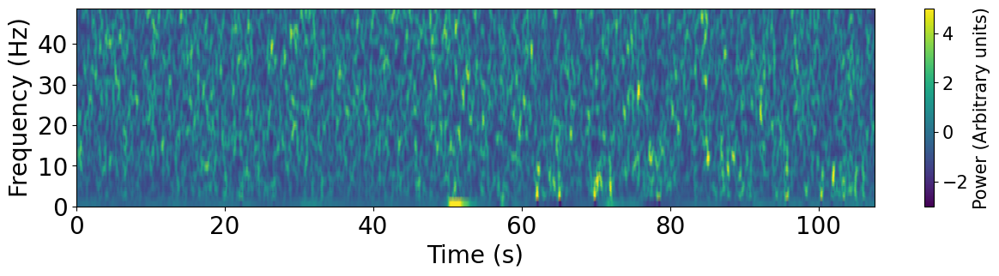

In [119]:
plot_stft(true_f, true_t, true_Zxx)

In [ ]:
# sftp_trial = SFTP.process_trial(channel_signal, results[0])

In [138]:
partitial_t = trials_info[0]["train"]["t"]
partitial_f = trials_info[0]["train"]["f"]
partitial_Zxx = trials_info[0]["train"]["Zxx"]

In [78]:
# partitial_t = sftp_trial['test']['t']
# partitial_f = sftp_trial['test']['f']
# partitial_Zxx = sftp_trial['test']['Zxx']

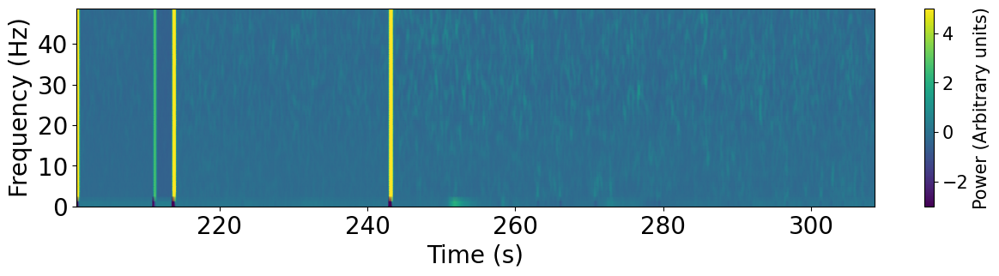

In [139]:
plot_stft(partitial_f, partitial_t, partitial_Zxx)

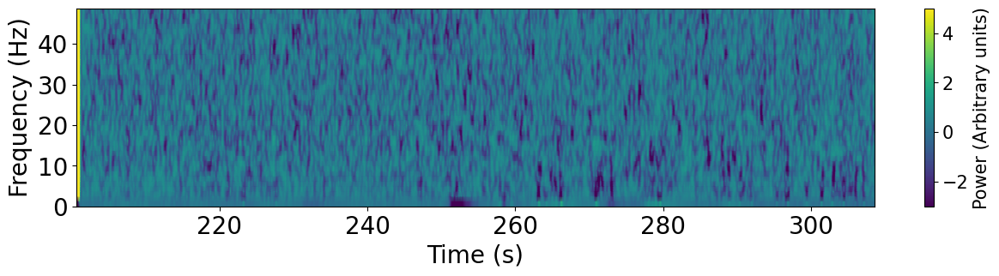

In [125]:
plot_stft(partitial_f, partitial_t, (partitial_Zxx - true_Zxx))

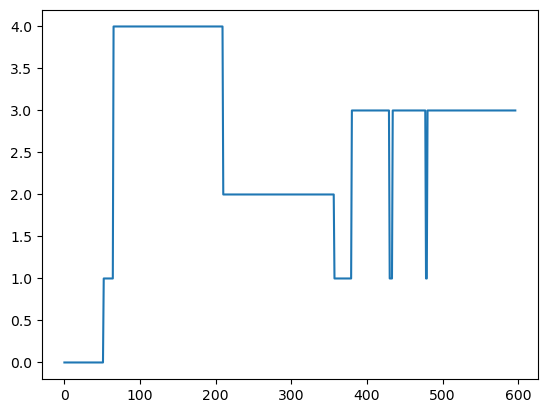

In [ ]:
plt.plot(trials_info[16]["train"]["labels"])

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

compute_class_weight(class_weight="balanced", classes=np.unique(y_test), y=y_test)

array([4.55576923, 9.476     , 0.27562536, 2.3       , 1.6337931 ])

In [ ]:
from collections import Counter

cnt = Counter(y_test)
dict(cnt)

{0: 104, 1: 50, 4: 290, 2: 1719, 3: 206}

In [ ]:
cnt = Counter(y_train)
dict(cnt)

{0: 1040, 1: 807, 4: 2914, 2: 2887, 3: 5167}

In [ ]:
labelencoder.classes_

array(['COUNTDOWN', 'OTHER', 'PROB', 'REC_WORD', 'WORD'], dtype='<U9')

In [ ]:
for i, trial in enumerate(trials_info):
    cnt = Counter(trial["train"]["labels"])
    print(f"{i}, {dict(cnt)}")

0, {0: 52, 1: 13, 4: 147, 2: 328}
1, {0: 52, 1: 108, 4: 147, 2: 117, 3: 75}
2, {0: 52, 1: 36, 4: 148, 2: 101, 3: 162}
3, {0: 52, 1: 39, 4: 145, 2: 113, 3: 190}
4, {0: 52, 1: 12, 4: 145, 2: 272}
5, {0: 52, 1: 12, 4: 144, 2: 1595}
6, {0: 52, 1: 88, 4: 144, 2: 186, 3: 154}
7, {0: 52, 1: 37, 4: 145, 2: 126, 3: 200}
8, {0: 52, 1: 43, 4: 145, 2: 145, 3: 178}
9, {0: 52, 1: 38, 4: 146, 2: 124, 3: 206}
10, {0: 52, 1: 29, 4: 145, 2: 108, 3: 168}
11, {0: 52, 1: 33, 4: 144, 2: 129, 3: 170}
12, {0: 52, 1: 27, 4: 148, 2: 100, 3: 2121}
13, {0: 52, 1: 29, 4: 147, 2: 113, 3: 160}
14, {0: 52, 1: 30, 4: 146, 2: 124, 3: 172}
15, {0: 52, 1: 34, 4: 146, 2: 120, 3: 167}
16, {0: 52, 1: 42, 4: 145, 2: 147, 3: 211}
17, {0: 52, 1: 67, 4: 144, 2: 160, 3: 160}
18, {0: 52, 1: 27, 4: 145, 2: 123, 3: 192}
19, {0: 52, 1: 30, 4: 147, 2: 119, 3: 184}
20, {0: 52, 1: 43, 4: 146, 2: 129, 3: 157}
21, {0: 52, 1: 40, 4: 145, 2: 127, 3: 346}


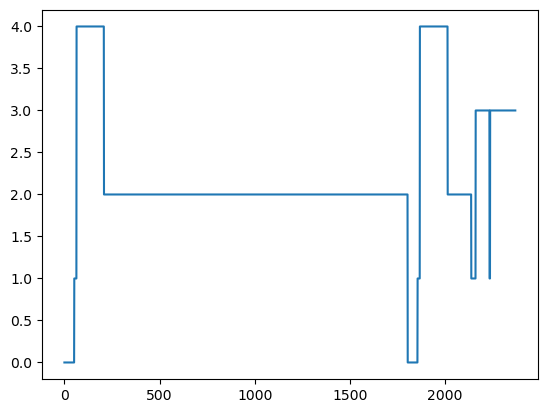

In [ ]:
plt.plot(y_test)

In [ ]:
X_test.shape

(2369, 768)

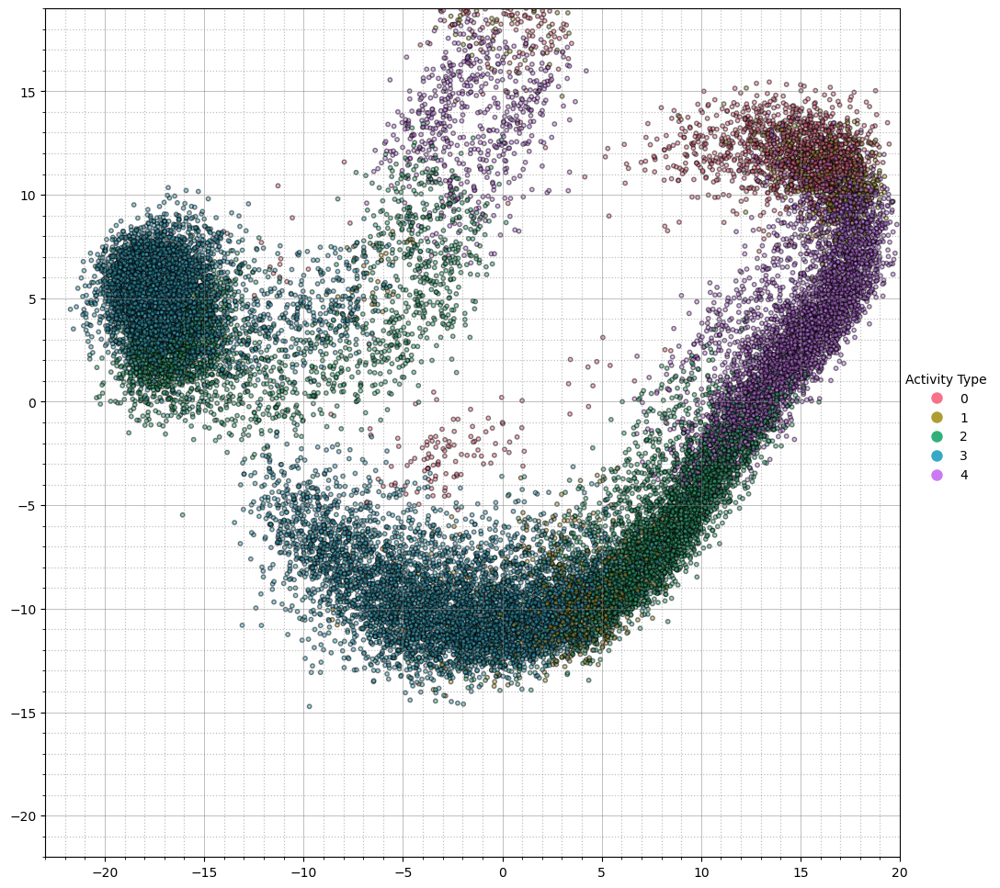

In [136]:
pca = PCA(n_components=2).fit(X_train)
# pca = TSNE(n_components=2, perplexity=min(30, all_models[0].shape[0] - 1), random_state=42)
# pca = umap.UMAP(n_components=2, random_state=42).fit(all_models[0])
fig, ax = plt.subplots(1, 1, figsize=(12, 12))

plt.subplots_adjust(right=0.90)  # Оставляем 15% ширины для легенды
ax.set_xlim(-23, 20)
ax.set_ylim(-22, 19)
ax.minorticks_on()
ax.grid(True, which="minor", linestyle=":", linewidth=0.9, color="gray", alpha=0.5)
ax.grid(True, which="major", linestyle="-", linewidth=0.5, color="gray", alpha=0.7)
# Цвета для activity_type
unique_activity_types = list(set(y_train))
colors = sns.husl_palette(len(unique_activity_types))
activity_color_map = {
    atype: color for atype, color in zip(unique_activity_types, colors)
}

points_by_activity = {atype: [] for atype in unique_activity_types}
proj = pca.transform(X_train)
for point, atype in zip(proj, y_train):
    points_by_activity[atype].append(point)
col = [activity_color_map[atype] for atype in y_train]
ax.scatter(proj[:, 0], proj[:, 1], color=col, s=10, edgecolor="k", alpha=0.5)


# Создаем легенду с элементами для всех типов активности
handles = [
    plt.Line2D(
        [0],
        [0],
        marker="o",
        color="w",
        label=atype,
        markerfacecolor=color,
        markersize=10,
    )
    for atype, color in activity_color_map.items()
]

# Проверяем, что handles не пустой
if handles:
    fig.legend(
        handles=handles,
        title="Activity Type",
        loc="center left",  # Привязываем к левому краю области для легенды
        bbox_to_anchor=(0.90, 0.5),  # Центрируем вертикально
        borderaxespad=0.0,  # Убираем лишние отступы
        frameon=False,  # Убираем рамку вокруг легенды
    )
plt.show()

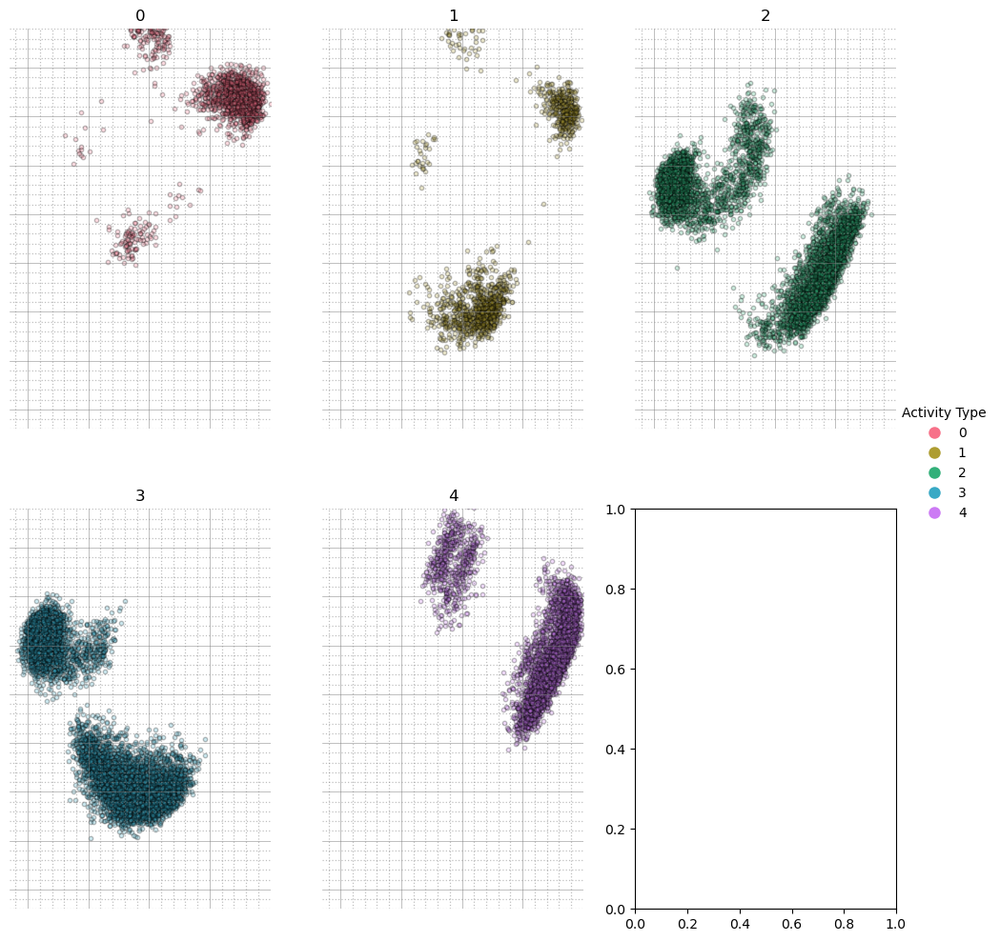

In [137]:
fig, axs = plt.subplots(2, 3, figsize=(12, 12))
plt.subplots_adjust(right=0.90)  # Оставляем 15% ширины для легенды

act_alignment = {}

for ax, atype in zip(axs.flatten(), unique_activity_types):
    ax.set_title(atype)
    ax.set_xlim(-23, 20)
    ax.set_ylim(-22, 19)

    ax.minorticks_on()
    ax.grid(True, which="minor", linestyle=":", linewidth=0.9, color="gray", alpha=0.5)
    ax.grid(True, which="major", linestyle="-", linewidth=0.5, color="gray", alpha=0.7)

    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["bottom"].set_visible(False)
    ax.spines["left"].set_visible(False)

    ax.tick_params(axis="both", which="both", length=0)
    ax.set_xticklabels([])
    ax.set_yticklabels([])

    act_alignment[atype] = ax

for atype, ax in act_alignment.items():
    pts = np.array(points_by_activity[atype])
    if pts.size > 0:
        ax.scatter(
            pts[:, 0],
            pts[:, 1],
            s=10,
            color=activity_color_map[atype],
            edgecolor="k",
            alpha=0.25,
        )

# Создаем легенду с элементами для всех типов активности
handles = [
    plt.Line2D(
        [0],
        [0],
        marker="o",
        color="w",
        label=atype,
        markerfacecolor=color,
        markersize=10,
    )
    for atype, color in activity_color_map.items()
]

# Проверяем, что handles не пустой
if handles:
    fig.legend(
        handles=handles,
        title="Activity Type",
        loc="center left",  # Привязываем к левому краю области для легенды
        bbox_to_anchor=(0.90, 0.5),  # Центрируем вертикально
        borderaxespad=0.0,  # Убираем лишние отступы
        frameon=False,  # Убираем рамку вокруг легенды
    )

plt.show()